In [1]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import numpy as np
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt

df = pd.read_csv('combined_IGI_airport.csv', parse_dates=['Timestamp'])
df.interpolate(method='linear', inplace=True)

scaler = MinMaxScaler()
scaled_features = scaler.fit_transform(df.iloc[:, 1:]) 

df_scaled = pd.DataFrame(scaled_features, columns=df.columns[1:])


In [2]:
def create_sequences(input_data, input_steps=168, output_steps=24, test_size=0.1):
    inputs, outputs = [], []
    j=0
    for i in range(0, len(input_data) - input_steps - output_steps, 192):
        inputs.append(input_data[i:(i+input_steps)])
        outputs.append(input_data[(i+input_steps):(i+input_steps+output_steps)])
        j+=1
    inputs = np.array(inputs)
    outputs = np.array(outputs)
    print(inputs.shape, outputs.shape)
    
    test_split_idx = int(len(inputs) * (1 - test_size))
    
    train_inputs=inputs[:test_split_idx]
    train_ouputs=outputs[:test_split_idx]
    test_inputs=inputs[test_split_idx:]
    test_outputs=outputs[test_split_idx:]
    return train_inputs, train_ouputs, test_inputs, test_outputs

train_inputs, train_outputs, test_inputs, test_outputs = create_sequences(df_scaled.values)
test_input_tensor = torch.tensor(test_inputs, dtype=torch.float32)
test_ouput_tensor = torch.tensor(test_outputs, dtype=torch.float32)

test_data = TensorDataset(test_input_tensor, test_ouput_tensor)
test_loader = DataLoader(test_data, batch_size=32)



(91, 168, 5) (91, 24, 5)


In [3]:
train_input, val_input, train_output, val_output = train_test_split(train_inputs, train_outputs, test_size=0.1, random_state=42)

train_input_tensor = torch.tensor(train_input, dtype=torch.float32)
train_output_tensor = torch.tensor(train_output, dtype=torch.float32)
val_input_tensor = torch.tensor(val_input, dtype=torch.float32)
val_output_tensor = torch.tensor(val_output, dtype=torch.float32)
train_data = TensorDataset(train_input_tensor, train_output_tensor)
val_data = TensorDataset(val_input_tensor, val_output_tensor)
train_loader = DataLoader(train_data, batch_size=1, shuffle=False)
val_loader = DataLoader(val_data, batch_size=1)


In [4]:
print(train_input_tensor.shape, train_output_tensor.shape)



torch.Size([72, 168, 5]) torch.Size([72, 24, 5])


In [5]:
class AirQualityLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        super(AirQualityLSTM, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        _, (h_n, _) = self.lstm(x)
        out = self.fc(h_n[-1])
        return out


input_size = 5
hidden_size = 100  
num_layers = 5
output_size = 5 * 24  

model = AirQualityLSTM(input_size, hidden_size, num_layers, output_size)


/home/cis/.local/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Epoch [1/20], Train Loss: 0.0370, Val Loss: 0.0227
Epoch [2/20], Train Loss: 0.0197, Val Loss: 0.0154
Epoch [3/20], Train Loss: 0.0170, Val Loss: 0.0151
Epoch [4/20], Train Loss: 0.0167, Val Loss: 0.0149
Epoch [5/20], Train Loss: 0.0164, Val Loss: 0.0146
Epoch [6/20], Train Loss: 0.0160, Val Loss: 0.0136
Epoch [7/20], Train Loss: 0.0150, Val Loss: 0.0139
Epoch [8/20], Train Loss: 0.0151, Val Loss: 0.0107
Epoch [9/20], Train Loss: 0.0142, Val Loss: 0.0101
Epoch [10/20], Train Loss: 0.0142, Val Loss: 0.0102
Epoch [11/20], Train Loss: 0.0138, Val Loss: 0.0101
Epoch [12/20], Train Loss: 0.0138, Val Loss: 0.0092
Epoch [13/20], Train Loss: 0.0136, Val Loss: 0.0090
Epoch [14/20], Train Loss: 0.0135, Val Loss: 0.0085
Epoch [15/20], Train Loss: 0.0134, Val Loss: 0.0083
Epoch [16/20], Train Loss: 0.0133, Val Loss: 0.0081
Epoch [17/20], Train Loss: 0.0132, Val Loss: 0.0080
Epoch [18/20], Train Loss: 0.0131, Val Loss: 0.0079
Epoch [19/20], Train Loss: 0.0131, Val Loss: 0.0078


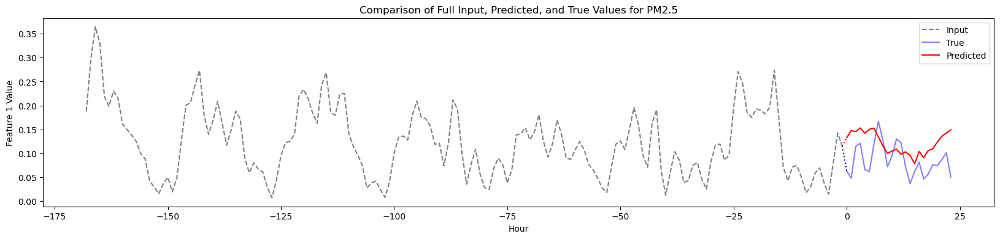

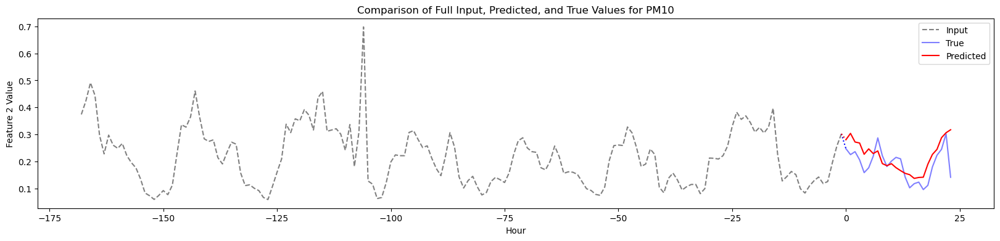

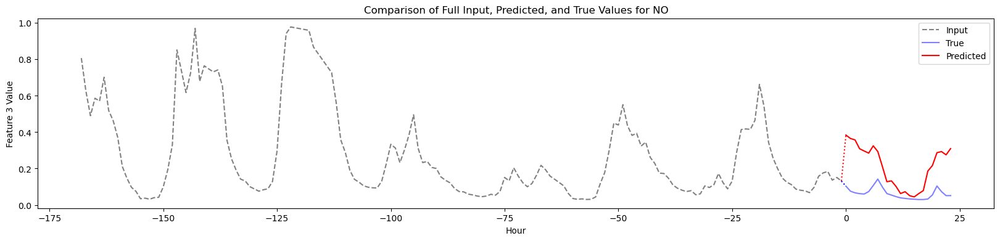

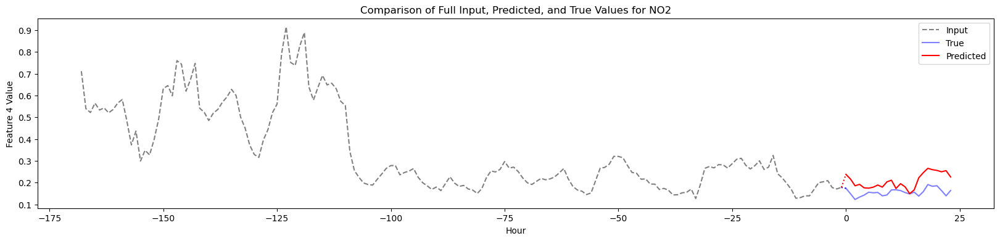

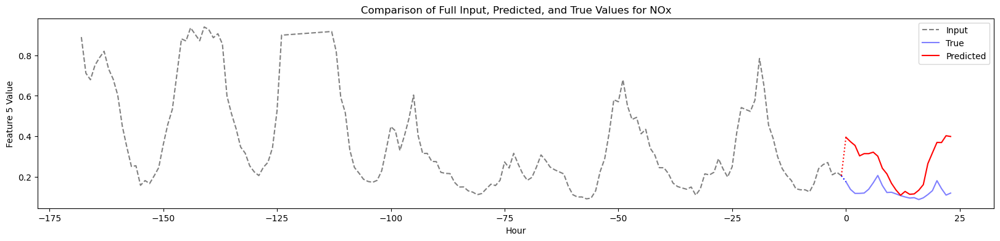

...

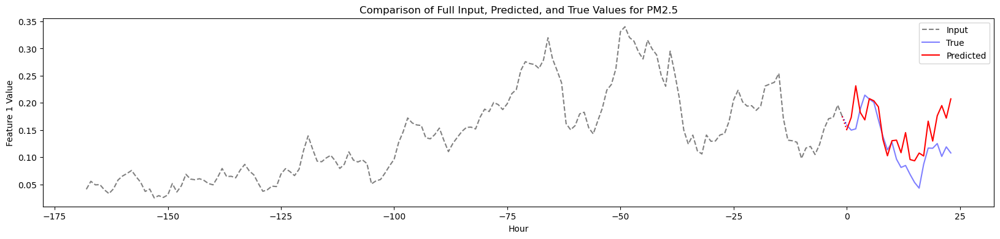

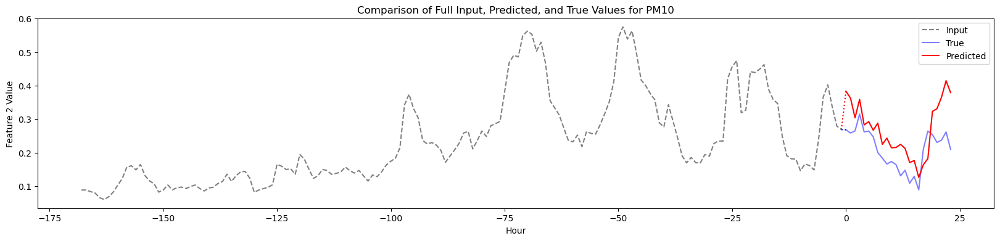

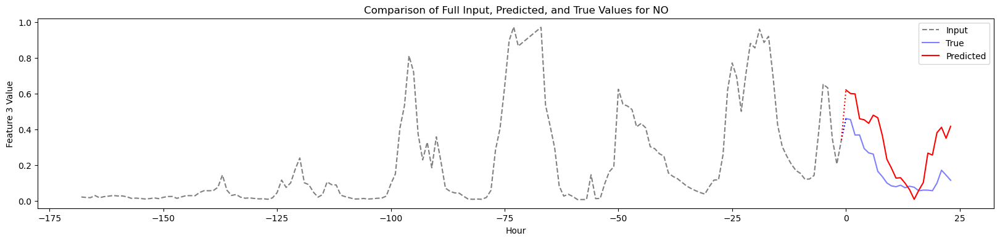

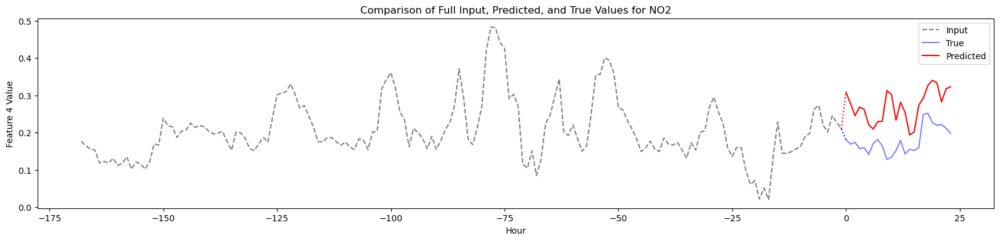

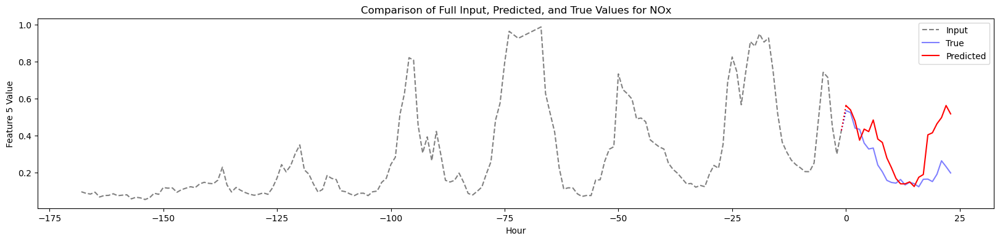

Epoch [20/20], Train Loss: 0.0130, Val Loss: 0.0076


In [6]:

import tqdm

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)


epochs = 20
features=['PM2.5', 'PM10', 'NO', 'NO2', 'NOx']

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

for epoch in range(epochs):
    model.train()  
    train_losses = []
    for input_batch, output_batch in train_loader:
        input_batch, output_batch = input_batch.to(device), output_batch.to(device)
        #print(X_batch.shape, y_batch.shape)
        
        

        outputs = model(input_batch)
        model_output_reshaped = outputs.view(outputs.size(0), 24, 5)

        
        input_batch_reshaped = input_batch.view(input_batch.size(0), 168, 5)
        
        y_batch_flat = output_batch.view(output_batch.size(0), -1)  # Reshaping to match output dimensions
        #print(y_batch_flat.shape)
        #print(outputs.shape)
        loss = criterion(outputs, y_batch_flat)
        
        #print(output_reshaped.shape, output_batch.shape)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        train_losses.append(loss.item())
        '''
        if epoch == 19:
            for i in range(5):
                plt.figure(figsize=(15, 4))
        
                # Transforming back the last input, true sequence, and predicted sequence
                last_input_transformed = scaler.inverse_transform(input_batch_reshaped[0][-24:, :])[:, i]
                true_sequence_transformed = scaler.inverse_transform(np.concatenate((input_batch_reshaped[0], output_batch[0].cpu().numpy()), axis=0))[-24:, i]
                predicted_sequence_transformed = scaler.inverse_transform(np.concatenate((input_batch_reshaped[0], model_output_reshaped[0].cpu().detach().numpy()), axis=0))[-24:, i]
        
                plt.plot(range(-24, 0), last_input_transformed, label='Input', color='gray', linestyle='dashed')
                plt.plot(range(0, 24), true_sequence_transformed, label='True', alpha=0.5, color='blue')
                plt.plot(range(0, 24), predicted_sequence_transformed, label='Predicted', color='red')
                plt.plot([-1, 0], [last_input_transformed[-1], true_sequence_transformed[0]], color='blue', linestyle='dotted')
                plt.plot([-1, 0], [last_input_transformed[-1], predicted_sequence_transformed[0]], color='red', linestyle='dotted')
                plt.title(f'Comparison of Input, Predicted, and True Values for {features[i]}')
                plt.xlabel('Hour')
                plt.ylabel(f'{features[i]} Value')
                plt.legend()
                plt.show()
                
        if epoch == 19:
            for i in range(5):  
                plt.figure(figsize=(20, 4))
        
                
                full_input = input_batch_reshaped[0][:, i].cpu().numpy()
        
                
                true_sequence = np.concatenate((full_input, output_batch[0][:, i].cpu().numpy()))
        
                
                plt.plot(range(-168, 0), full_input, label='Input', color='gray', linestyle='dashed')
        
                
                plt.plot(range(0, 24), true_sequence[168:], label='True', alpha=0.5, color='blue')
        
                
                predicted_sequence = model_output_reshaped[0][:, i].cpu().detach().numpy()
                plt.plot(range(0, 24), predicted_sequence, label='Predicted', color='red')
                
                plt.plot([-1, 0], [full_input[-1], true_sequence[168]], color='blue', linestyle='dotted')
                plt.plot([-1, 0], [full_input[-1], predicted_sequence[0]], color='red', linestyle='dotted')
                plt.title(f'Comparison of Full Input, Predicted, and True Values for {features[i]}')
                plt.xlabel('Hour')
                plt.ylabel(f'Feature {i+1} Value')
                plt.legend()
                plt.show()
'''
    



    
    # Validation step
    model.eval()
    val_losses = []
    with torch.no_grad():
        for val_input_batch, val_output_batch in val_loader:
            val_input_batch, val_output_batch = val_input_batch.to(device), val_output_batch.to(device)
            outputs = model(val_input_batch)
            val_output_batch_flat = val_output_batch.view(val_output_batch.size(0), -1)  # Reshaping for loss calculation
            loss = criterion(outputs, val_output_batch_flat)
            val_losses.append(loss.item())
    
    print(f'Epoch [{epoch+1}/{epochs}], Train Loss: {np.mean(train_losses):.4f}, Val Loss: {np.mean(val_losses):.4f}')

torch.save(model.state_dict(), 'air_quality_lstm_model.pth')


In [7]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
import torch

# Ensure the model is in evaluation mode
model.eval()

# Lists to store actual and predicted values
actuals = []
predictions = []

# No gradient calculation needed
with torch.no_grad():
    for inputs, targets in val_loader:
        inputs, targets = inputs.to(device), targets.to(device)
        
        # Get model predictions
        outputs = model(inputs)
        
        # Reshape or process outputs if necessary, depending on your model's output shape
        outputs = outputs.view(targets.size())  # Adjust this line if necessary
        
        # Store predictions and actual values
        predictions.extend(outputs.cpu().numpy())
        actuals.extend(targets.cpu().numpy())

# Convert lists to numpy arrays for calculation
actuals = np.array(actuals)
predictions = np.array(predictions)

# Calculate evaluation metrics
mae = mean_absolute_error(actuals, predictions)
mse = mean_squared_error(actuals, predictions)
rmse = np.sqrt(mse)

print(f"Mean Absolute Error (MAE): {mae:.4f}")
print(f"Mean Squared Error (MSE): {mse:.4f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")

ValueError: Found array with dim 3. None expected <= 2.